In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import tensorflow as tf
from tensorflow import keras
import matplotlib.pyplot as plt
import os
import time
from sklearn.metrics import classification_report, confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, models

2023-12-06 16:01:36.863275: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2023-12-06 16:01:36.885929: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2023-12-06 16:01:36.885953: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2023-12-06 16:01:36.886584: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2023-12-06 16:01:36.890875: I tensorflow/core/platform/cpu_feature_guar

In [2]:
import os
for dirname, _, filenames in os.walk('./data/cifar-10-batches-py'):
    print(dirname)
    for filename in filenames:
        print(os.path.join(dirname, filename))


./data/cifar-10-batches-py
./data/cifar-10-batches-py/readme.html
./data/cifar-10-batches-py/data_batch_5
./data/cifar-10-batches-py/data_batch_3
./data/cifar-10-batches-py/batches.meta
./data/cifar-10-batches-py/data_batch_2
./data/cifar-10-batches-py/data_batch_4
./data/cifar-10-batches-py/test_batch
./data/cifar-10-batches-py/data_batch_1


In [3]:
(train_images, train_labels), (test_images, test_labels) = keras.datasets.cifar10.load_data()

In [4]:
CLASS_NAMES= ['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck']

In [5]:
train_ds=tf.data.Dataset.from_tensor_slices((train_images,train_labels))
test_ds=tf.data.Dataset.from_tensor_slices((test_images,test_labels))

2023-12-06 16:01:38.505701: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-12-06 16:01:38.522810: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2023-12-06 16:01:38.522984: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

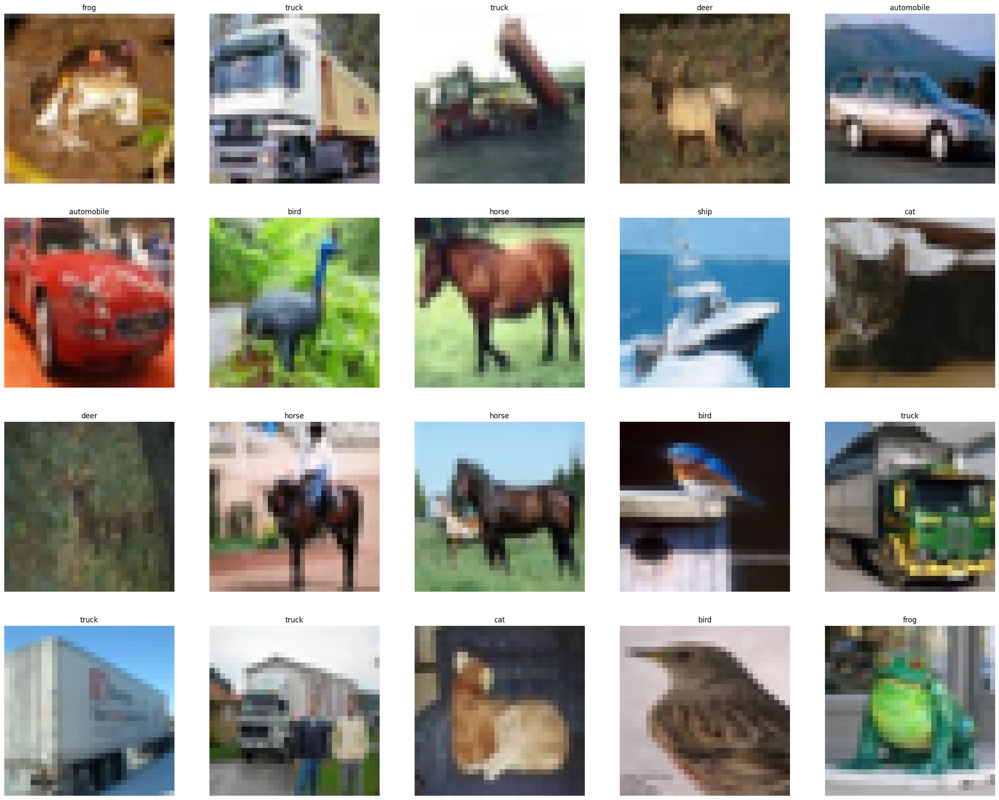

In [6]:
plt.figure(figsize=(30,30))
for i,(image,label) in enumerate(train_ds.take(20)):
    #print(label)
    ax=plt.subplot(5,5,i+1)
    plt.imshow(image)
    plt.title(CLASS_NAMES[label.numpy()[0]])
    plt.axis('off')

In [7]:
def process_image(image, label):
    image = tf.image.per_image_standardization(image)
    image = tf.image.resize(image, (227, 227))  # Corrigir o redimensionamento para o tamanho esperado pelo modelo AlexNet
    return image, label

In [8]:
train_ds_size = tf.data.experimental.cardinality(train_ds).numpy()
test_ds_size = tf.data.experimental.cardinality(test_ds).numpy()
print('Train size:', train_ds_size)
print('Test size:', test_ds_size)
# Train size: 50000
# Test size: 10000

Train size: 50000
Test size: 10000


In [9]:
train_ds = (train_ds
            .map(process_image)
            .shuffle(buffer_size=train_ds_size)
            .batch(batch_size=32, drop_remainder=True)
            )
test_ds = (test_ds
           .map(process_image)
           .shuffle(buffer_size=test_ds_size)
           .batch(batch_size=32, drop_remainder=True)
           )

In [10]:
def alexnet_model(input_shape, num_classes):
    model = models.Sequential()
    
    # Capa 1
    model.add(layers.Conv2D(96, (11, 11), strides=(4, 4), activation='relu', input_shape=input_shape))
    model.add(layers.MaxPooling2D((3, 3), strides=(2, 2)))

    # Capa 2
    model.add(layers.Conv2D(256, (5, 5), padding='same', activation='relu'))
    model.add(layers.MaxPooling2D((3, 3), strides=(2, 2)))

    # Capa 3
    model.add(layers.Conv2D(384, (3, 3), padding='same', activation='relu'))

    # Capa 4
    model.add(layers.Conv2D(384, (3, 3), padding='same', activation='relu'))

    # Capa 5
    model.add(layers.Conv2D(256, (3, 3), padding='same', activation='relu'))
    model.add(layers.MaxPooling2D((2, 2), strides=(2, 2)))  # Adjusted pool_size and strides

    # Capa Flatten
    model.add(layers.Flatten())

    # Capas completamente conectadas
    model.add(layers.Dense(4096, activation='relu'))
    model.add(layers.Dropout(0.5))
    model.add(layers.Dense(4096, activation='relu'))
    model.add(layers.Dropout(0.5))
    model.add(layers.Dense(num_classes, activation='softmax'))

    return model

In [11]:
model_alex_net = alexnet_model((227, 227, 3), len(CLASS_NAMES))

In [12]:
model_alex_net.compile(
    loss='sparse_categorical_crossentropy',
    optimizer=tf.optimizers.SGD(lr=0.001),
    metrics=['accuracy']    
)
model_alex_net.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 55, 55, 96)        34944     
                                                                 
 max_pooling2d (MaxPooling2  (None, 27, 27, 96)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 27, 27, 256)       614656    
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 13, 13, 256)       0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 13, 13, 384)       885120    
                                                                 
 conv2d_3 (Conv2D)           (None, 13, 13, 384)       1

In [14]:
history=model_alex_net.fit(
    train_ds,
    epochs=5,
    validation_data=test_ds,
    validation_freq=1
)

2023-12-06 16:05:01.245969: W external/local_tsl/tsl/framework/bfc_allocator.cc:485] Allocator (mklcpu) ran out of memory trying to allocate 603.9KiB (rounded to 618496)requested by op resize/ResizeBilinear
If the cause is memory fragmentation maybe the environment variable 'TF_GPU_ALLOCATOR=cuda_malloc_async' will improve the situation. 
Current allocation summary follows.
Current allocation summary follows.
2023-12-06 16:05:01.246240: I external/local_tsl/tsl/framework/bfc_allocator.cc:1039] BFCAllocator dump for mklcpu
2023-12-06 16:05:01.246257: I external/local_tsl/tsl/framework/bfc_allocator.cc:1046] Bin (256): 	Total Chunks: 0, Chunks in use: 0. 0B allocated for chunks. 0B in use in bin. 0B client-requested in use in bin.
2023-12-06 16:05:01.246259: I external/local_tsl/tsl/framework/bfc_allocator.cc:1046] Bin (512): 	Total Chunks: 0, Chunks in use: 0. 0B allocated for chunks. 0B in use in bin. 0B client-requested in use in bin.
2023-12-06 16:05:01.246261: I external/local_tsl/t

In [ ]:
model_alex_net.history.history.keys()

dict_keys(['loss', 'accuracy', 'val_loss', 'val_accuracy'])

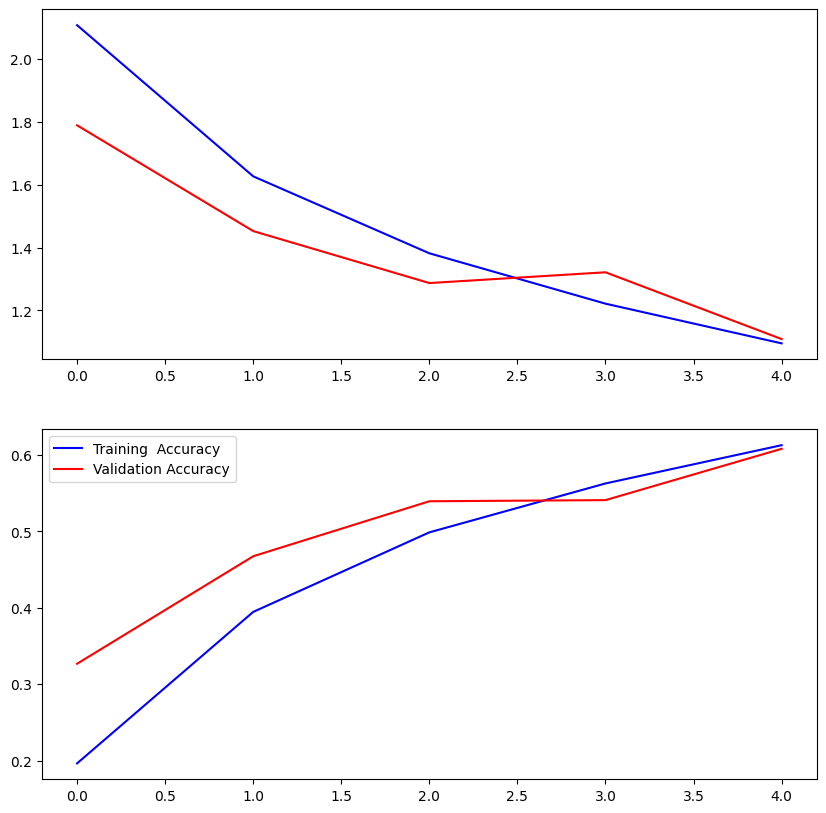

In [ ]:
f,ax=plt.subplots(2,1,figsize=(10,10)) 

#Assigning the first subplot to graph training loss and validation loss
ax[0].plot(model_alex_net.history.history['loss'],color='b',label='Training Loss')
ax[0].plot(model_alex_net.history.history['val_loss'],color='r',label='Validation Loss')

#Plotting the training accuracy and validation accuracy
ax[1].plot(model_alex_net.history.history['accuracy'],color='b',label='Training  Accuracy')
ax[1].plot(model_alex_net.history.history['val_accuracy'],color='r',label='Validation Accuracy')

plt.legend()

In [ ]:
print('Accuracy Score = ',np.max(history.history['val_accuracy']))

Accuracy Score =  0.6078726053237915


In [ ]:
# Plot confusion matrix
def plot_confusion_matrix(model, x_test, y_test, classes):
    y_pred = np.argmax(model.predict(x_test), axis=1)
    cm = confusion_matrix(y_test, y_pred)
    
    plt.figure(figsize=(len(classes), len(classes)))
    sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=classes, yticklabels=classes)
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.title('Confusion Matrix')
    plt.show()

# Evaluate model
def evaluate_model(model, x_test, y_test, classes):
    y_pred = np.argmax(model.predict(x_test), axis=1)
    print("Classification Report:")
    print(classification_report(y_test, y_pred, target_names=classes))
    plot_confusion_matrix(model, x_test, y_test, classes)


In [ ]:
# Evaluate the model
evaluate_model(model_alex_net, test_images, test_labels, CLASS_NAMES)


ValueError: in user code:

    File "/home/romulolass/Codes/trab_pratico_VC/.venv/lib/python3.11/site-packages/keras/src/engine/training.py", line 2440, in predict_function  *
        return step_function(self, iterator)
    File "/home/romulolass/Codes/trab_pratico_VC/.venv/lib/python3.11/site-packages/keras/src/engine/training.py", line 2425, in step_function  **
        outputs = model.distribute_strategy.run(run_step, args=(data,))
    File "/home/romulolass/Codes/trab_pratico_VC/.venv/lib/python3.11/site-packages/keras/src/engine/training.py", line 2413, in run_step  **
        outputs = model.predict_step(data)
    File "/home/romulolass/Codes/trab_pratico_VC/.venv/lib/python3.11/site-packages/keras/src/engine/training.py", line 2381, in predict_step
        return self(x, training=False)
    File "/home/romulolass/Codes/trab_pratico_VC/.venv/lib/python3.11/site-packages/keras/src/utils/traceback_utils.py", line 70, in error_handler
        raise e.with_traceback(filtered_tb) from None
    File "/home/romulolass/Codes/trab_pratico_VC/.venv/lib/python3.11/site-packages/keras/src/engine/input_spec.py", line 298, in assert_input_compatibility
        raise ValueError(

    ValueError: Input 0 of layer "sequential" is incompatible with the layer: expected shape=(None, 64, 64, 3), found shape=(None, 32, 32, 3)


In [ ]:

# Plot training history
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.legend()
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss Over Time')
plt.show()